# Определение жанра по изображению обложки музыкального диска

Необходимо разработать модель, которая определит жанр музыкального альбома по изображению его обложки.

Изображения в формате PNG, упакованны в zip-архивы. Имя архива соответствует музыкальному жанру. Каждый zip-архив содержит папку с изображениями музыкальных обложек соответствующего жанра.

В качестве метрики для мультиклассовой классификации будет использована `Accuracy`

&copy; by Копцев Андрей [<img src="https://upload.wikimedia.org/wikipedia/commons/8/82/Telegram_logo.svg" alt="Telegram" width="17"/>](https://t.me/Andrei_VK_1980)

## Импорты

In [1]:
import os
import copy
import shutil
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import notebook, tqdm
from PIL import Image
import pickle
import warnings
import gc

from functools import wraps
import time

from sklearn.metrics import classification_report
import faiss
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader

import torchvision.models as models
from torchvision import transforms
from torchvision.transforms import v2
from torchvision.datasets import ImageFolder
from torchvision.models.feature_extraction import get_graph_node_names, create_feature_extractor

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)
pd.set_option("max_colwidth", 200)

warnings.filterwarnings("ignore")

**Переменные**

In [2]:
RANDOM = 12345
# рабочая директория проекта
WORK_DIR = os.path.abspath(os.curdir)
# директория c изображениями
IMG_DIR = os.path.join(WORK_DIR, "images")
# директории с изображениями для train, valid, test
TRAIN_DIR = os.path.join(IMG_DIR, "train")
VALID_DIR = os.path.join(IMG_DIR, "valid")
TEST_DIR = os.path.join(IMG_DIR, "test")
# директория для сохранения датасетов и весторов
OUTPUT_DIR = os.path.join(WORK_DIR, "outputs")
# директория для сохранения обучненных моделей
OUTPUT_DIR_MODELS = os.path.join(OUTPUT_DIR, "models")
# устройсто cpu или gpu
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")
# random seed
torch.manual_seed(RANDOM)
np.random.seed(RANDOM)

### Временной декоратор `TimeitDecorator`

Для подсчета времени выполнения методов обработки и моделирования, можно использовать временной декоратор реализованный в виде класса `TimeitDecorator`.

In [3]:
class TimeitDecorator:
    """
    Класс для декоратора, который измеряет время выполнения функции.
    """

    def timeit(func):
        """
        Декоратор, который измеряет время выполнения функции.

        Параметры:
        - func: функция, для которой измеряется время выполнения

        Возвращает:
        - wrapper: обертка, которая измеряет время выполнения функции
        """

        @wraps(func)
        def wrapper(*args, **kwargs):
            """
            Обертка, которая измеряет время выполнения функции.

            Параметры:
            - args: позиционные аргументы функции
            - kwargs: именованные аргументы функции

            Возвращает:
            - result: результат выполнения функции
            """
            start_time = time.time()
            result = func(*args, **kwargs)
            end_time = time.time()
            print(
                f"Время выполнения: {round(end_time - start_time, 2)} секунд(ы)"
            )

            return result

        return wrapper

## Подготовка данных

В корневой папке проекта создана директория `images` - путь к ней хранится в переменной, в нее соотвественно распаковываются архивы с изображениями в папки по жанрам `anime`,  `black metal`, `classical`, `country`, `disco`, `edm`, `jazz`, `pop`, `rap`, `reggae`.

Далее структура следующая:
- создаются поддиректории `train`, `valid`, `test`;
- в них перемещаются файлы в пропорции: `train` - `80%`, `valid` - `10%`, и остаток в `test`;
- удаляем из `images` папки `anime`,  `black metal`, `classical`, `country`, `disco`, `edm`, `jazz`, `pop`, `rap`, `reggae`;
- создаем датасет со столбцами `data` - значения `train`, `valid`, `test`, `genre` - жанр, он же целевой признак, `img_path` - пути к изображениям.

Датасет понадобиться в дальнейцем для векторизации изображении и поиска ближайших соседей.

Все это реализовано в функции `get_train_val_test_folders`. Последовательность действий функции описана в комментариях к коду.

### Функция `get_train_val_test_folders`

In [4]:
def get_train_val_test_folders(img_dir=None, train_percent=0.8, valid_percent=0.1):
    """
    Функция get_train_val_test_folders реализует след. функционал:
     - создает папки train, valid, test,
     - в них перемещаются файлы в пропорции: `train` - `80%`, 
                                            `valid` - `10%`  
                                            и остаток в `test`;
     - удаляет папки `anime`,  `black metal`, `classical`, 
                     `country`, `disco`, `edm`, `jazz`, `pop`, `rap`, `reggae`;
     - создает датасет со столбцами `data` - значения `train`, `valid`, `test`, 
                     `genre` - жанр, он же целевой признак (по названию папки), 
                     `img_path` - пути к изображениям.

    Параметры:
    - img_dir (str): директория с папками с изображеними (по умолчанию None),
    - train_percent (float): размер данных для train (по умолчанию 0.8),
    - valid_percent (float): размер данных для valid (по умолчанию 0.1).

    Возвращает:
    - df (pd.DataFrame): датафрейм с данными.
    """

    # Создаем переменную для хранения поддиректорий
    base_folders = os.listdir(img_dir)
    # Создаем папки train, valid и test с проверкой на существование папок
    os.makedirs(os.path.join(img_dir, "train"), exist_ok=True)
    os.makedirs(os.path.join(img_dir, "valid"), exist_ok=True)
    os.makedirs(os.path.join(img_dir, "test"), exist_ok=True)
    # Создаем переменные с путями к train, valid и test
    train_dir = os.path.join(img_dir, "train")
    valid_dir = os.path.join(img_dir, "valid")
    test_dir = os.path.join(img_dir, "test")
    # Проходим циклом по списку с поддиректориями base_folders
    for folder in base_folders:
        # Создаем в train, valid и test те же папки, что в base_folders
        os.makedirs(os.path.join(train_dir, folder), exist_ok=True)
        os.makedirs(os.path.join(valid_dir, folder), exist_ok=True)
        os.makedirs(os.path.join(test_dir, folder), exist_ok=True)
        # Получаем список файлов в текущей папке
        curr_folder = os.path.join(img_dir, folder)
        files = os.listdir(curr_folder)
        # Разделяем количество файлов на train, valid и test
        num_files = len(files)
        num_train = int(num_files * train_percent)
        num_valid = int(num_files * valid_percent)
        num_test = num_files - num_train - num_valid
        # Перемещаем файлы в соответствующие папки при помощи shutil.copyfile
        for i, file in enumerate(files):
            # Копируем в train
            if i < num_train:
                shutil.copyfile(os.path.join(curr_folder, file),
                                os.path.join(train_dir, folder, file))
            # Копируем в valid
            elif i < num_train + num_valid:
                shutil.copyfile(os.path.join(curr_folder, file),
                                os.path.join(valid_dir, folder, file))
            # Копируем в test
            elif i < num_train + num_valid + num_test:
                shutil.copyfile(os.path.join(curr_folder, file),
                                os.path.join(test_dir, folder, file))
    # Проходим циклом по списку с поддиректориями base_folders
    for directory in base_folders:
        # Удаляем бызовые папки с файлами
        try:
            shutil.rmtree(os.path.join(img_dir, directory))
        # В случае невозможности вызываем ошибку
        except Exception as e:
            print(
                f"Ошибка при удалении директории {os.path.join(img_dir, directory)}: {e}")
    # Список для хранения данных для создания датасета
    data_list = []
    # Проходим по каждой из train, valid, test
    for dataset_type in ["train", "valid", "test"]:
        # Создаем переменную с путем в train, valid, test
        dataset_path = os.path.join(img_dir, dataset_type)
        # Проходим по каждой папке внутри train, valid, test
        for genre_folder in os.listdir(dataset_path):
            # Создаем переменную с путем к каждой поддиректории в train, valid, test
            genre_path = os.path.join(dataset_path, genre_folder)
            # Проходим по каждому файлу в папке жанра
            for file_name in os.listdir(genre_path):
                # Создаем переменную с путем к файлу в каждой поддиректории в train, valid, test
                file_path = os.path.join(genre_path, file_name)
                # Добавляем данные в список
                data_list.append(
                    {"data": dataset_type, "genre": genre_folder, "img_path": file_path})
    # Создаем DataFrame из списка
    df = pd.DataFrame(data_list)
    # Возвращаем датасет
    return df

Далее вызываем функцию и сохраняем датасет в папку `OUTPUT_DIR` c `zip` сжатием для уменьшения места на диске.

In [5]:
data = get_train_val_test_folders(img_dir=IMG_DIR, train_percent=0.8, valid_percent = 0.1)
data.to_pickle(os.path.join(OUTPUT_DIR, "data.pkl"), compression="zip")

Данные подготовлены.

## Создание датасетов и даталоадеров для обучения нейросети.

Прежде чем создать датасет нужно задать структуру преобразования файла в тензор `pytorch`. Для этого можно использовать модуль V2 из `torchvision.transforms`.

In [6]:
# Создается объект Compose, который объединяет список преобразований изображения в последовательную цепочку.
# Это позволяет применять все преобразования к изображению в заданном порядке.
image_transforms_v2 = v2.Compose([
    # Пеобразование изменяет размер изображения до указанного размера (в данном случае 224x224 пикселя)
    v2.Resize(size=224),
    # Преобразование преобразует входные данные в объект изображения в виде тензора
    v2.ToImage(),
    # Преобразование изменяет тип данных изображения на torch.float32, что является типом данных,
    # обычно используемым для работы с нейронными сетями. Параметр scale=True масштабирует значения
    # пикселей в диапазон от 0 до 1,
    v2.ToDtype(dtype=torch.float32, scale=True),
    # Это преобразование нормализует значения пикселей изображения.
    # Первый аргумент - это средние значения для каждого канала изображения, а второй аргумент -
    # это стандартные отклонения для каждого канала. Параметр inplace=True указывает на то,
    # что нормализация будет выполнена непосредственно в том же тензоре, что и изображение, что экономит память.
    v2.Normalize([0.485, 0.456, 0.406],
                 [0.229, 0.224, 0.225], inplace=True)
])

Объекты данных для обучения, валидации и тестирования нейронной сети будут созданы через `ImageFolder`.
- Создается объект `ImageFolder`, который представляет набор данных для обучения модели,
- `root=...` указывает на директорию, содержащую изображения для обучения,
- `transform=image_transforms_v2` применяет последовательность преобразований, определенную ранее в `image_transforms_v2`, к каждому изображению в наборе данных.

In [7]:
# train
train_data = ImageFolder(root=TRAIN_DIR, transform=image_transforms_v2)
# valid
valid_data = ImageFolder(root=VALID_DIR, transform=image_transforms_v2)
# test
test_data = ImageFolder(root=TEST_DIR, transform=image_transforms_v2)

Проверяем классы в объектах для обучения.

In [8]:
train_data.classes

['anime',
 'black metal',
 'classical',
 'country',
 'disco',
 'edm',
 'jazz',
 'pop',
 'rap',
 'reggae']

Все жанры на месте, Также проверим словарь с перекодировкой меток в числа.

In [9]:
train_data.class_to_idx

{'anime': 0,
 'black metal': 1,
 'classical': 2,
 'country': 3,
 'disco': 4,
 'edm': 5,
 'jazz': 6,
 'pop': 7,
 'rap': 8,
 'reggae': 9}

Все закодировано.

Создадим словарь для обратной перекодировки. Это понадобится для предсказаний модели.

In [10]:
idx_to_class = dict((v,k) for k,v in train_data.class_to_idx.items())
idx_to_class

{0: 'anime',
 1: 'black metal',
 2: 'classical',
 3: 'country',
 4: 'disco',
 5: 'edm',
 6: 'jazz',
 7: 'pop',
 8: 'rap',
 9: 'reggae'}

Проверим правильность загрузки на соответствие изображения жанру.

Класс изображения: anime
Размерность тензора изображения: torch.Size([3, 224, 224])


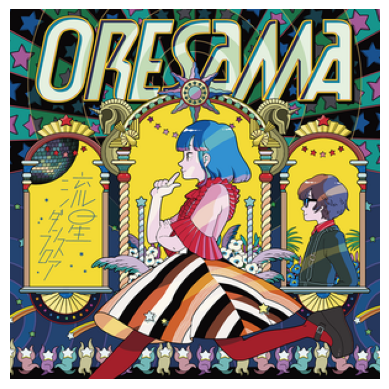

In [11]:
img, ohe_pos = train_data[10]
cls = train_data.classes[ohe_pos]
print(f"Класс изображения: {cls}")
print(f"Размерность тензора изображения: {img.shape}")
plt.imshow(Image.open(train_data.imgs[10][0]).convert('RGB'))
plt.axis('off')
plt.show()

Все верно.

Далее создаем объекты `DataLoader` для наборов данных. С `batch_size=48` (размер мини-пакета (`batch`) для обучения), `shuffle=True` указывает, что порядок изображений в наборе данных должен быть перемешан перед каждой эпохой обучения. Это помогает предотвратить переобучение. Используется только в `train`.

In [12]:
# train
train_loader = DataLoader(train_data, batch_size=48, shuffle=True)
# valid
valid_loader = DataLoader(valid_data, batch_size=48, shuffle=False)
# test
test_loader = DataLoader(test_data, batch_size=48, shuffle=False)

Размеры выборок.

In [13]:
print(f"Длина train данных: {len(train_loader.dataset)}")
print(f"Длина valid данных: {len(valid_loader.dataset)}")
print(f"Длина test данных: {len(test_loader.dataset)}")

Длина train данных: 6236
Длина valid данных: 775
Длина test данных: 789


## Модель для обучения нейросети.

В качестве решения задачи классификации был выбран вариант `Transfer Learning`.  Перепробованы раздичные варианты для `ResNet` моделей, но результат был не очень хороший. 

Остановился на варианте `Vision Transformer` - `vit_l_16` c весами `IMAGENET1K_SWAG_LINEAR_V1`. Модель достаточно тяжелая, но более точная.

Помимо этого для улучшения метрики я добавил на выход модели, следующие слои:
- `nn.Linear(num_classes, num_classes)`,
- `nn.BatchNorm1d(num_classes)`,
- `nn.ReLU()`,
- `nn.LSTM(num_classes, num_classes, num_layers=1, batch_first=True)`,
- `nn.ReLU()`,
- `nn.Dropout(p=0.25)`,
- `nn.Linear(num_classes, num_classes)`,
где `num_classes` это наши 10 классов.

За счет этой модификации удалось еще немного увеличить метрику.

Ниже класс `CustomTorchVisionNet` c комментариями к коду.

In [14]:
class CustomTorchVisionNet(nn.Module):
    """
    Нейронная сеть Vision Transformer для многоклассовой классификации.
    """

    def __init__(self, model_name=None, weights=None, num_classes=10):
        super(CustomTorchVisionNet, self).__init__()
        """
        Инициализация класса CustomTorchVisionNet.
        
        Параметры:
        model_name (str): Имя модели (по умолчанию None).
        weights (str): Веса модели (по умолчанию None).
        num_classes (int): Количество классов на выходе (по умолчанию 10).
        """
        # Получаем список доступных моделей TorchVision
        self.classification_models = models.list_models(module=models)
        # Условный оператор match выполняется с именем модели и делает следующее:
        match model_name:
            # Если model_name находится в списке доступных моделей
            case _ if model_name in self.classification_models:
                # oн загружает модель с указанным именем и весами.
                self.model = models.get_model(model_name, weights=weights)
            # Если model_name не находится в списке, он выводит сообщение об ошибке
            case _: raise ValueError(f"Неправильная модель")
        # Замораживаем параметры загруженной модели, чтобы избежать их обновления при обучении
        for param in self.model.parameters():
            param.requires_grad = False
        # Условный оператор match выполняется и заменяет последний полностью связанный слой
        # загруженной модели новым слоем, чтобы соответствовать новому количеству классов.
        # Конкретные действия зависят от типа загруженной модели. Все модели имеют на выходе 1000 классов.
        # У каждой модели из https://pytorch.org/vision/stable/models.html есть свой вариант.
        match model_name:
            # Для "resnet", "regnet", "resnext", "wide_resnet", "shufflenet", "googlenet"
            case _ if any(model in model_name for model in ["resnet", "regnet", "resnext", "wide_resnet", "shufflenet", "googlenet"]):
                # Входная размерность последнего слоя
                num_ftrs = self.model.fc.in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.fc = nn.Linear(num_ftrs, num_classes)
            # Для "alexnet", "vgg"
            case _ if any(model in model_name for model in ["alexnet", "vgg"]):
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier[6].in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier[6] = nn.Linear(num_ftrs, num_classes)
            # Для "efficientnet", "mobilenet_v2", "mnasnet"
            case _ if any(model in model_name for model in ["efficientnet", "mobilenet_v2", "mnasnet"]):
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier[1].in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier[1] = nn.Linear(num_ftrs, num_classes)
            # Для "mobilenet_v3"
            case _ if "mobilenet_v3" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier[3].in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier[3] = nn.Linear(num_ftrs, num_classes)
            # Для "convnext"
            case _ if "convnext" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier[2].in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier[2] = nn.Linear(num_ftrs, num_classes)
            # Для "maxvit"
            case _ if "maxvit" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier[5].in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier[5] = nn.Linear(num_ftrs, num_classes)
            # Для "squeezenet"
            case _ if "squeezenet" in model_name:
                # Входная размерность последнего слоя
                self.model.classifier[1] = nn.Conv2d(
                    512, num_classes, kernel_size=(1, 1), stride=(1, 1))
                # Меняем последний выходной слой на выход с num_classes
                self.model.num_classes = num_classes
            # Для "swin"
            case _ if "swin" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.head.in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.head = nn.Linear(num_ftrs, num_classes)
            # Для "vit"
            case _ if "vit" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.heads.head.in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.heads.head = nn.Linear(num_ftrs, num_classes)
            # Для "densenet"
            case _ if "densenet" in model_name:
                # Входная размерность последнего слоя
                num_ftrs = self.model.classifier.in_features
                # Меняем последний выходной слой на выход с num_classes
                self.model.classifier = nn.Linear(num_ftrs, num_classes)
            # Вызов ошибки, если нету таких моделей
            case _: raise ValueError(f"Неправильная модель")

        # Дополнительный полностью связанный слой
        self.linear_0 = nn.Linear(num_classes, num_classes)
        # Дополнительный слой LSTM
        self.lstm = nn.LSTM(num_classes, num_classes,
                            num_layers=1, batch_first=True)
        # Дополнительный полностью связанный слой
        self.linear_1 = nn.Linear(num_classes, num_classes)
        # Функция активации ReLU
        self.act = nn.ReLU()
        # Слой Dropout с вероятностью 0,25
        self.dropout = nn.Dropout(p=0.25)
        # Слой нормализации
        self.batchnorm = nn.BatchNorm1d(num_classes)
        # Атрибуты экземпляра класса для построения графиков, сохранения моделей
        # Список со значениями функции потерь на каждой эпохе для train
        self.train_loss_lst = []
        # Список со значениями функции потерь на каждой эпохе для valid
        self.val_loss_lst = []
        # Список со значениями метрики accuracy на каждой эпохе для train
        self.train_acc_lst = []
        # Список со значениями метрики accuracy на каждой эпохе для valid
        self.val_acc_lst = []
        # Список со значениями lr
        self.lr_lst = []
        # Лучший loss
        self.best_loss = None
        # Лучшая эпоха
        self.best_epoch = 0
        # Счетчик эпох
        self.count = 0

    def forward(self, x):
        """
        Метод прямого распространения для нейронной сети.
        """
        # Прямое распространение через исходную загруженную модель
        out = self.model(x)
        # Дополнительный полностью связанный слой
        out = self.linear_0(out)
        # Нормализацию
        out = self.batchnorm(out)
        # Сохраняем копию выхода
        x = out
        # Применяем активацию ReLU
        out = self.act(out)
        # Выполняем прямое распространение через слой LSTM
        out, _ = self.lstm(out)
        # Суммируем выход LSTM с исходным выходом и применяем активацию ReLU
        out = self.act(out+x)
        # Дропаут
        out = self.dropout(out)
        # Пропускаем выход через полностью связанный слой
        out = self.linear_1(out)
        # Выходные данные сети
        return out

    @TimeitDecorator.timeit  # Временной декоратор
    def fit(self, train_loader, val_loader, loss_fn, optimizer, n_epochs=100, early_stopping_patience=5, device='cpu', lr_sheduler=None, output_dir=None):
        """
        Обучение модели нейронной сети.

        Параметры:
        - train_loader (DataLoader): Загрузчик обучающих данных.
        - val_loader (DataLoader): Загрузчик валидационных данных.
        - loss_fn: Функция потерь.
        - optimizer: Оптимизатор.
        - n_epochs (int): Количество эпох обучения (по умолчанию 100).
        - early_stopping_patience (int): Параметр для ранней остановки (по умолчанию 5). 
        - device (str): Устройство для обучения (cpu или cuda) (по умолчанию cpu).
        - lr_sheduler: Планировщик для управления скоростью обучения (по умолчанию None).
        - output_dir (str): Директория для сохранения моделей (по умолчанию None).
        """
        # Переводим модель и функцию потерь на выбранное устройство device
        self.to(device)
        loss_fn.to(device)
        # Счетчик начала обучения для цикла
        start = self.best_epoch + 1
        # Цикл обучения по эпохам, от start, start + n_epochs такой выбор обучловлен
        # для дообучения моделей
        for epoch in range(start, start + n_epochs):
            # Модель в режим обучения
            self.train()
            # Создаем пустой список для значения функции потерь внутри эпохи
            train_loss = []
            # Количество правильных ответов модели на эпохе, изначально 0
            true_answer = 0
            # Создаем tqdm итератор для вывода прогресс бара
            train_loop = tqdm(train_loader, leave=False)
            # Цикл по батчам
            for inputs, labels in train_loop:
                # Переводим входные данные на выбранное устройство device
                inputs = inputs.to(device)
                # Преобразуем тензор меток labels в одномерный тензор и преобразуем
                # его к типу данных torch.int32
                labels = labels.reshape(-1).to(torch.int32)
                # Создаем тензор горячего кодирования для меток. torch.eye(10) создаем
                # единичную матрицу 10x10, где каждое число представляет один класс.
                # labels используется для индексирования строк в единичной матрице, и полученный
                # тензор содержит один столбец с 1 для каждого класса. Этот тензор также перемещается
                # на указанное устройство.
                labels = torch.eye(10)[labels].to(device)
                # Прямое распространение через модель
                outputs = self(inputs)
                # Вычисляем функцию потерь
                loss = loss_fn(outputs, labels)
                # Сбрасываем градиенты всех параметров модели до нуля.
                optimizer.zero_grad()
                # Выполняем обратное распространение через модель.
                loss.backward()
                # Обновляем параметры модели на основе вычисленных градиентов.
                optimizer.step()
                # Добавляем лосс в список
                train_loss.append(loss.item())
                # Считаем средний лосс
                mean_train_loss = sum(train_loss) / len(train_loss)
                # Считаем количество правильных предсказаний
                true_answer += (outputs.argmax(dim=1) ==
                                labels.argmax(dim=1)).sum().item()
                # Устанавливаем подпись к tqdm прогресс бару
                train_loop.set_description(
                    f"Эпоха ---> {epoch}/{start + n_epochs - 1}, Train Loss ---> {mean_train_loss:.4f}")
            # Считаем метрику accuracy
            train_acc = true_answer / len(train_loader.dataset)
            # Добавляем в атрибуты класса лосс и accuracy по эпохе
            self.train_loss_lst.append(mean_train_loss)
            self.train_acc_lst.append(train_acc)
            # Переводим модель в режим предсказания без градиентов
            self.eval()
            with torch.no_grad():
                # Создаем пустой список для значения функции потерь внутри эпохи
                val_loss = []
                # Количество правильных ответов модели на эпохе, изначально 0
                true_answer = 0
                # Создаем tqdm итератор для вывода прогресс бара
                valid_loop = tqdm(valid_loader, leave=False)
                # Цикл по батчам
                for inputs, labels in valid_loop:
                    # Переводим входные данные на выбранное устройство device
                    inputs = inputs.to(device)
                    # Преобразуем тензор меток labels в одномерный тензор и преобразуем
                    # его к типу данных torch.int32
                    labels = labels.reshape(-1).to(torch.int32)
                    # Создаем тензор горячего кодирования для меток. torch.eye(10) создаем
                    # единичную матрицу 10x10, где каждое число представляет один класс.
                    # labels используется для индексирования строк в единичной матрице, и полученный
                    # тензор содержит один столбец с 1 для каждого класса. Этот тензор также перемещается
                    # на указанное устройство.
                    labels = torch.eye(10)[labels].to(device)
                    # Прямое распространение через модель
                    outputs = self(inputs)
                    # Вычисляем функцию потерь
                    loss = loss_fn(outputs, labels)
                    # Добавляем лосс в список
                    val_loss.append(loss.item())
                    # Считаем средний лосс
                    mean_val_loss = sum(val_loss) / len(val_loss)
                    # Считаем количество правильных предсказаний
                    true_answer += (outputs.argmax(dim=1) ==
                                    labels.argmax(dim=1)).sum().item()
                    # Устанавливаем подпись к tqdm прогресс бару
                    valid_loop.set_description(
                        f"Эпоха ---> {epoch}/{start + n_epochs - 1}, Valid Loss ---> {mean_val_loss:.4f}")
                # Считаем метрику accuracy
                val_acc = true_answer / len(valid_loader.dataset)
                # Добавляем в атрибуты класса лосс и accuracy по эпохе
                self.val_loss_lst.append(mean_val_loss)
                self.val_acc_lst.append(val_acc)
            # Если задан планировщик скорости обучения, он выполняет шаг по последнему значению функции
            # потерь проверки (для текущей эпохи).
            if lr_sheduler is not None:
                lr_sheduler.step(self.val_loss_lst[epoch-1])
                # Текущий lr
                curr_lr = lr_sheduler._last_lr[0]
                # Добавляем текущий lr в список
                self.lr_lst.append(curr_lr)
            # Иначе
            else:
                # Берем текущий lr
                curr_lr = optimizer.param_groups[0]['lr']
                # и добавляем в список
                self.lr_lst.append(curr_lr)
            # Вывод показателей после каждой эпохи
            tqdm.write(f"Epoch [{epoch}/{start + n_epochs - 1}], Loss Train: {mean_train_loss:.4f}, Accuracy Train: {train_acc:.4f} , Loss Valid: {mean_val_loss:.4f}, Accuracy Valid: {val_acc:.4f}, Learning Rate: {curr_lr}")
            # Инициализируем лучшую потерю как среднюю потерю первой эпохе, если она еще не определена.
            if self.best_loss is None:
                self.best_loss = mean_val_loss
            # Проверяем, меньше ли средняя потеря на проверке, чем лучшая потеря,
            # или текущая эпоха является начальной.
            if mean_val_loss < self.best_loss or epoch == start:
                # Сохраняем лучший лосс
                self.best_loss = mean_val_loss
                # Обнуляем счетчик для early_stopping
                self.count = 0
                # Сохраняем лучшую эпоху
                self.best_epoch = epoch
                # Создаем словарь для сохранения состояния модели, оптимизатора,
                # планировщика скорости обучения, потерь, метрик, скорости обучения и эпох.
                checkpoint_model = {
                    "state_model": self.state_dict(),
                    "state_optimizer": optimizer.state_dict(),
                    "state_sheduler": lr_sheduler.state_dict(),
                    "loss": {
                        "train_loss": self.train_loss_lst,
                        "validation_loss": self.val_loss_lst,
                        "best_loss": self.best_loss
                    },
                    "metric": {
                        "train_accuracy": self.train_acc_lst,
                        "validation_accuracy": self.val_acc_lst,
                    },
                    "learning rate": self.lr_lst,
                    "epoch": {
                        "total_epochs": n_epochs,
                        "best_epoch": self.best_epoch
                    }
                }
                # Сохраняеv словарь состояния модели в файл`.pt` в указанном выходном каталоге.
                torch.save(checkpoint_model, os.path.join(
                    output_dir, f"model_state_dict_epoch_{epoch}.pt"))
                # Cообщение о том, что модель была сохранена с текущей потерей на проверке и точностью на проверке.
                tqdm.write(
                    f"На эпохе {epoch} сохранена модель со значением функции потерь ---> {mean_val_loss:.4f} и значением метрики Accuracy ---> {val_acc:.4f} на валидации.", end="\n")
                # Проверяем, достиг ли счетчик ранней остановки заданного значения.
                # Если да, выводим сообщение о том, что обучение было остановлено,
                # и выходим из цикла обучения.
                if self.count >= early_stopping_patience:
                    tqdm.write(f"Обучение остановлено на {epoch} эпохе.")
                    break
                # Увеличиваем счетчик на единицу
                self.count += 1

    @TimeitDecorator.timeit  # Временной декоратор
    def predict(self, test_loader, idx_to_class_dict=None, device="cpu"):
        """
        Получение предсказаний нейронной сети.

        Параметры:
        - test_loader (DataLoader): Загрузчик тестовых данных.
        - idx_to_class_dict (dict): Словарь для перевода меток в жанры (по умолчанию None).
        - device (str): Устройство для обучения (cpu или cuda) (по умолчанию cpu).
        Возвращает: 
        - preds (list): Список с предсказанными жанрами.
        """
        # Переводим модель на выбранное устройство device
        self.to(device)
        # Создаем пустую матрицу для добавления предсказаний и переводим на выбранное устройство device
        concatenated_preds = torch.empty(0, 10).to(device)
        # Переводим модель в режим предсказания без градиентов
        self.eval()
        with torch.no_grad():
            # Количество правильных ответов модели на эпохе, изначально 0
            true_answer = 0
            # Создаем tqdm итератор для вывода прогресс бара
            test_loop = tqdm(test_loader, leave=True)
            # Цикл по батчам
            for inputs, labels in test_loop:
                # Переводим входные данные на выбранное устройство device
                inputs = inputs.to(device)
                # Преобразуем тензор меток labels в одномерный тензор и преобразуем
                # его к типу данных torch.int32
                labels = labels.reshape(-1).to(torch.int32)
                # Создаем тензор горячего кодирования для меток. torch.eye(10) создаем
                # единичную матрицу 10x10, где каждое число представляет один класс.
                # labels используется для индексирования строк в единичной матрице, и полученный
                # тензор содержит один столбец с 1 для каждого класса. Этот тензор также перемещается
                # на указанное устройство.
                labels = torch.eye(10)[labels].to(device)
                # Прямое распространение через модель
                outputs = self(inputs)
                # Добавляем предсказания в concatenated_preds
                concatenated_preds = torch.cat(
                    (concatenated_preds, outputs), dim=0)
                # Считаем количество правильных предсказаний
                true_answer += (outputs.argmax(dim=1) ==
                                labels.argmax(dim=1)).sum().item()
                # Устанавливаем подпись к tqdm прогресс бару
                test_loop.set_description(
                    f"Получаем предсказания на тестовой выборке.")
            # Считаем метрику accuracy
            test_acc = true_answer / len(test_loader.dataset)
        # Переводим в режим cpu, убираем градиенты и преобразовываем в numpy
        concat_preds = concatenated_preds.cpu().detach().numpy()
        # Считаем индексы максимальных элементов
        indices = np.argmax(concat_preds, axis=1)
        # Перекодируем индексы в жанры
        preds = [idx_to_class_dict[index] for index in indices]
        # Вывод метрики
        tqdm.write(f"Метрика Accuracy на тестовой выборке ---> {test_acc:.4f}")
        # Создаем список реальными метками из test_loader.dataset.imgs
        true_labels = [item[1] for item in test_loader.dataset.imgs]
        # Перекодируем жанры
        true_labels = [idx_to_class_dict[label] for label in true_labels]
        # Выводим classification_report по всем жанрам
        print(classification_report(true_labels, preds))
        # Возврат предсказанных значений
        return preds

    def metric_loss_lr_plot(self):
        """
        Метод для визуализации параметров обучения.
        Параметры:
        - Нет входных параметров, все параметры беруться из атрибутов экземпляра 
          класса.
        Возвращает:
        - Нет возвращаемого значения, функция выводит на экран результат обучения в 
          виде графиков.

        """
        # Задаем размер общего графика
        plt.figure(figsize=(16, 6))
        # Первый сабплот для метрики accuracy
        plt.subplot(1, 3, 1)
        # Создаем график accuracy для train из атрибута класса train_acc_lst
        plt.plot(range(1, len(self.train_acc_lst)+1),
                 self.train_acc_lst, label="Accuracy на обучении")
        # Создаем график accuracy для valid из атрибута класса val_acc_lst
        plt.plot(range(1, len(self.val_acc_lst)+1),
                 self.val_acc_lst, label="Accuracy на валидации")
        # Наносим на график вертикальную линию с лучшех эпохой
        plt.vlines(x=self.best_epoch, ymin=0,
                   ymax=1, color='r', linestyle='--')
        # Легенда слева вверху
        plt.legend(loc="upper left")
        # Заголовок
        plt.title(
            f"Accuracy\nBest Val Accuracy ---> {self.val_acc_lst[self.best_epoch-1]:.4f}\nBest Epoch ---> {self.best_epoch}")
        # Второй сабплот для значений функции потерь
        plt.subplot(1, 3, 2)
        # Создаем график функции потерь для train из атрибута класса train_loss_lst
        plt.plot(range(1, len(self.train_loss_lst)+1),
                 self.train_loss_lst, label="Loss на обучении")
        # Создаем график функции потерь для valid из атрибута класса val_loss_lst
        plt.plot(range(1, len(self.val_loss_lst)+1),
                 self.val_loss_lst, label="Loss на валидации")
        # Наносим на график вертикальную линию с лучшех эпохой
        plt.vlines(x=self.best_epoch, ymin=0, ymax=max(
            self.train_loss_lst), color="r", linestyle='--')
        # Легенда справа вверху
        plt.legend(loc="upper right")
        # Заголовок
        plt.title(
            f"Loss Function\nBest Val Loss ---> {self.val_loss_lst[self.best_epoch-1]:.4f}\nBest Epoch ---> {self.best_epoch}")
        # Второй сабплот для lr
        plt.subplot(1, 3, 3)
        # Создаем график изменения lr из атрибута класса lr_lst
        plt.plot(range(1, len(self.lr_lst)+1),
                 self.lr_lst, label="LR на обучении")
        # Легенда справа вверху
        plt.legend(loc="upper right")
        # Заголовок
        plt.title("Learning Rate")
        # Вывод графика
        plt.show()

    @TimeitDecorator.timeit  # Временной декоратор
    def load_model(self, model_dir=None, model_file=None, device="cpu"):
        """
        Загрузка модели из сохраненного файла.

        Параметры:
        - model_dir (str): Директория с моделью (по умолчанию None).
        - model_file (str): Файл с моделью (по умолчанию None).
        - device (str): Устройство для обучения (cpu или cuda) (по умолчанию cpu).
        Возвращает: self(model), optimizer, lr_sheduler
        """
        # Загружаем параметры модели, с указанием устройтсва map_location=device
        model_parameters = torch.load(os.path.join(
            model_dir, model_file), map_location=device)
        # Загружаем сами параметры модели из словаря
        self.load_state_dict(model_parameters["state_model"])
        # Загружаем параметры оптимизатора из словаря
        optimizer.load_state_dict(model_parameters["state_optimizer"])
        # Загружаем параметры шедулера из словаря
        lr_sheduler.load_state_dict(model_parameters["state_sheduler"])
        # Загружаем атрибуты экжемляра класса из словаря
        self.train_loss_lst = model_parameters["loss"]["train_loss"]
        self.val_loss_lst = model_parameters["loss"]["validation_loss"]
        self.best_loss = model_parameters["loss"]["best_loss"]
        self.train_acc_lst = model_parameters["metric"]["train_accuracy"]
        self.val_acc_lst = model_parameters["metric"]["validation_accuracy"]
        self.lr_lst = model_parameters["learning rate"]
        self.best_epoch = model_parameters["epoch"]["best_epoch"]
        # Возвращаем модель, оптимизатор и шедулер
        return self, optimizer, lr_sheduler

Возможны разные варианты:
- модель закончит обучени на не самой лучшей эпохе,
- обучение проходи долго и дообучаться можно по несколько эпох и на них не будет улучшения,
- иные технические проблемы.
Для этого можно одтельно реализовать функцию сохранения модели на текущей законченной эпохе.

In [15]:
def save_model(model, optimizer, lr_sheduler, total_epochs, last_epoch, output_dir):
    """
    Функция save_model для сохранения модели

    Параметры:
    - model (torch.nn.Module): Модель.
    - optimizer (torch.optim.optimizer): Оптимизатор.
    - lr_sheduler (torch.optim.lr_scheduler): scheduler,
    - total_epochs (int): Количество эпох.
    - last_epoch (int): Последняя эпоха.
    - output_dir (str): Директория для сохранения.

    Возвращает:
    - Нет возвращаемого значения, функция cохраняет модель в файл.

    """
    # Создаем словарь для сохранения состояния модели, оптимизатора,
    # планировщика скорости обучения, потерь, метрик, скорости обучения и эпох.
    checkpoint_model = {
        "state_model": model.state_dict(),
        "state_optimizer": optimizer.state_dict(),
        "state_sheduler": lr_sheduler.state_dict(),
        "loss": {
            "train_loss": model.train_loss_lst,
            "validation_loss": model.val_loss_lst,
            "best_loss": model.best_loss
        },
        "metric": {
            "train_accuracy": model.train_acc_lst,
            "validation_accuracy": model.val_acc_lst,
        },
        "learning rate": model.lr_lst,
        "epoch": {
            "total_epochs": total_epochs,
            "best_epoch": model.best_epoch
        }
    }
    # Сохраняеv словарь состояния модели в файл`.pt` в указанном выходном каталоге.
    torch.save(checkpoint_model, os.path.join(
        output_dir, f"model_state_dict_epoch_{last_epoch}.pt"))

Кроме всего прочего существует еще один ньюанс...

При загрузке модели из файла с `map_location="cpu"` для дальнейшего обучения при условии, что все необходимые элементы будут переведены на `gpu` может возникнуть ошибка 

` RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu!`

на шаге 

`optimizer.step()`

Решить это можно воспользовавшись ссылкой https://github.com/pytorch/pytorch/issues/8741#issuecomment-402129385

In [16]:
def optimizer_to(optim, device):
    """
    Функция optimizer_to.
    Основная цель этой функции - перенести параметры и градиенты оптимизатора 
    на указанное устройство. 
    Параметры:
    - optimizer (torch.optim.optimizer): Оптимизатор.
    - device (str): Устройство для обучения (cpu или cuda)
    Возвращает:
    - Нет возвращаемого значения, функция обеспечивает перевод параметров и 
         градиентов оптимизатора на указанное устройство.
    """
    # Код итерируется по всем параметрам, хранящимся в optim.state (состояние оптимизатора).
    # Для каждого параметра проверяется, является ли он тензором PyTorch (torch.Tensor):
    # - Если да, то данные тензора и его градиента (если он существует)
    # перемещаются на указанное устройство.
    # Если параметр является словарем (dict), то функция обрабатывает
    # все подпараметры в этом словаре, применяя ту же логику, что и для тензоров.
    # Таким образом, этот код обеспечивает, что все параметры и градиенты оптимизатора
    # будут находиться на том же устройстве, что и модель.
    for param in optim.state.values():
        if isinstance(param, torch.Tensor):
            param.data = param.data.to(device)
            if param._grad is not None:
                param._grad.data = param._grad.data.to(device)
        elif isinstance(param, dict):
            for subparam in param.values():
                if isinstance(subparam, torch.Tensor):
                    subparam.data = subparam.data.to(device)
                    if subparam._grad is not None:
                        subparam._grad.data = subparam._grad.data.to(device)


def scheduler_to(sched, device):
    """
    Функция scheduler_to.
    Основная цель этой функции - перенести 
    тензоры в объекте планировщика (scheduler) на указанное устройство
    Параметры:
    - sched (torch.optim.lr_scheduler): scheduler.
    - device (str): Устройство для обучения (cpu или cuda)

    Возвращает:
    - Нет возвращаемого значения, функция обеспечивает, что все параметры 
         планировщика будут находиться на том же устройстве, что и модель 
         и оптимизатор.
    """
    # Код итерируется по всем параметрам, хранящимся в sched.dict (словарь, содержащий параметры планировщика).
    # Для каждого параметра проверяется, является ли он тензором PyTorch (torch.Tensor):
    # Если да, то данные тензора и его градиента (если он существует) перемещаются на указанное устройство.
    # Таким образом, эта функция обеспечивает, что все параметры планировщика будут находиться
    # на том же устройстве, что и модель и оптимизатор.
    for param in sched.__dict__.values():
        if isinstance(param, torch.Tensor):
            param.data = param.data.to(device)
            if param._grad is not None:
                param._grad.data = param._grad.data.to(device)

# optimizer_to(optimizer, device)
# scheduler_to(lr_sheduler, device)

**Инициализация модели**

In [17]:
model = CustomTorchVisionNet(
    model_name="vit_l_16", weights="IMAGENET1K_SWAG_LINEAR_V1")

**Проверка вывода модели**

In [18]:
# Предположим, у нас есть тензор input_data размером [batch_size, 3, 224, 224]
input_data = torch.randn(5, 3, 224, 224)
output = model(input_data)
print(output.shape)  # Размерность выхода должна быть: [batch_size, 10]

torch.Size([5, 10])


Тензор на выходе правильный

**Loss Function, Optimizer, Sheduler**

In [19]:
# Функция потерь cross-entropy, которая используется для классификационных задач.
# Она сочетает в себе логарифмическую функцию потерь и softmax-активацию на выходе модели.
loss_fn = nn.CrossEntropyLoss()
# Оптимизатор Adam с начальной скоростью обучения 0.01
# и коэффициентом регуляризации weight_decay, равным 0.0001.
optimizer = optim.Adam(model.parameters(), lr=0.01, weight_decay=0.0001)
# Планировщика скорости обучения, который уменьшает скорость обучения, когда метрика
# (в данном случае функция потерь) перестает улучшаться.
# - Основные параметры:
#  - mode="min": планировщик ждет, пока метрика не перестанет уменьшаться.
#  - factor=0.1: при срабатывании планировщика скорость обучения уменьшается в 10 раз (на 90%).
#  - patience=2: планировщик ждет 2 эпохи без улучшения метрики, прежде чем уменьшить скорость обучения.
#  - threshold=0.0001, threshold_mode="rel": планировщик ждет, пока относительное изменение метрики не станет меньше 0.0001.
#  - cooldown=0: после срабатывания планировщика нет дополнительной задержки перед следующим изменением скорости обучения.
#  - min_lr=1e-9: минимальная допустимая скорость обучения.
#  - eps=1e-8: минимальное абсолютное изменение скорости обучения, чтобы считать ее значимым.
lr_sheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                   mode="min",
                                                   factor=0.1,
                                                   patience=2,
                                                   threshold=0.0001,
                                                   threshold_mode="rel",
                                                   cooldown=0,
                                                   min_lr=1e-9,
                                                   eps=1e-8)

**Обучение модели**

Т.к модель тяжелая и обучение каждой эпохи заняло около 2 часов, то модель была обучена заранее и сохранена на лучших и последней эпохе.
Всего обучалась 15 эпох.

In [20]:
# Обучение на 15 эпохах
model.fit(train_loader, valid_loader, loss_fn, optimizer, n_epochs=15, early_stopping_patience=5, device=device, lr_sheduler=lr_sheduler, output_dir=OUTPUT_DIR_MODELS)
# Сохранение подели на последней эпохе
save_model(model, optimizer, lr_sheduler, 15, 15, OUTPUT_DIR_MODELS)

Ниже сохранненый отчет по обучению модели.

![title](mkdn_img/model_fit.png)

**Визуализация параметров обучения**

Для визуализации загрузим модель сохранненую на последней эпохе.

In [21]:
# Инициализируем модель
model = CustomTorchVisionNet(
    model_name="vit_l_16", weights="IMAGENET1K_SWAG_LINEAR_V1")
# Загружаем на последней эпохе
model, _, _ = model.load_model(
    model_dir=OUTPUT_DIR_MODELS, model_file="model_state_dict_epoch_15.pt")

Время выполнения: 6.69 секунд(ы)


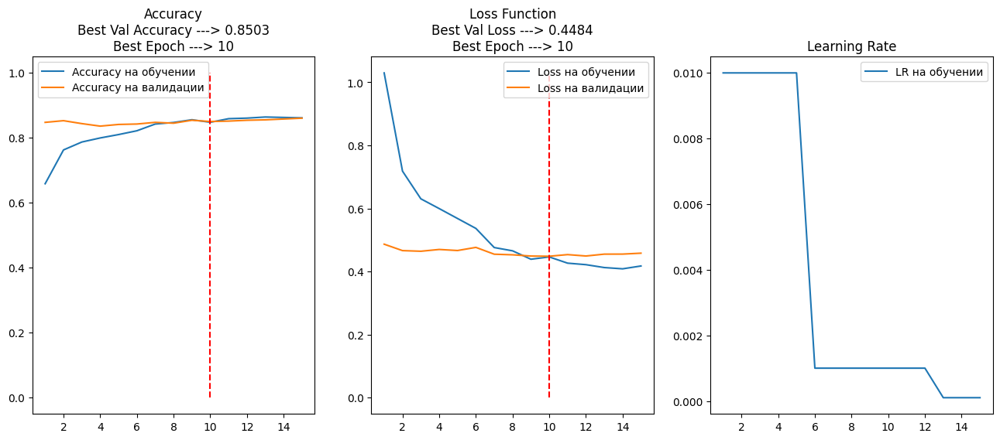

In [22]:
model.metric_loss_lr_plot()

Переобучения удалось избежать. Лучшая эпоха как раз находится в точке расхождения `Train Loss` и `Val Loss`.

Первоначально более низкая метрика на трейне обусловлена дропаутом.

## Проверка модели на тестовой выборке.

Для этого перезагрузим сохранненую модель на лучшей 10 эпохе.

In [23]:
# Загружаем на последней лучшей эпохе
model, _, _ = model.load_model(
    model_dir=OUTPUT_DIR_MODELS, model_file="model_state_dict_epoch_10.pt")

Время выполнения: 2.6 секунд(ы)


**Результат**

Предсказания получим на `cpu`.

In [24]:
preds = model.predict(
    test_loader, idx_to_class_dict=idx_to_class, device="cpu")

Получаем предсказания на тестовой выборке.: 100%|██████████| 17/17 [16:39<00:00, 58.78s/it]

Метрика Accuracy на тестовой выборке ---> 0.8276
              precision    recall  f1-score   support

       anime       0.97      0.97      0.97       120
 black metal       0.96      0.98      0.97        45
   classical       0.95      0.93      0.94        96
     country       0.86      0.87      0.86       150
       disco       0.74      0.52      0.61        48
         edm       0.80      0.70      0.74        73
        jazz       0.71      0.73      0.72        83
         pop       0.59      0.72      0.65        81
         rap       0.84      0.79      0.82        34
      reggae       0.80      0.88      0.84        59

    accuracy                           0.83       789
   macro avg       0.82      0.81      0.81       789
weighted avg       0.83      0.83      0.83       789

Время выполнения: 999.25 секунд(ы)


Результат на тесте чуть хуже валидационного.

По жанрам:
- очень хорошо распознаются: `anime`, `black metal`, `classical`,
- хорошо: `country`, `rap`, `reggae`,
- плохо: `edm`, `jazz`,
- совсем плохо: `disco`, `pop`.

Это связано с характером изображений. Ниже при поиске ближайших соседей это будет более детально показано.

## Векторизация изображений

Для начала загрузим ранее сохранненый датасет с жанрами и путями к изображениям

In [25]:
data = pd.read_pickle(os.path.join(OUTPUT_DIR, "data.pkl"), compression="zip")

In [26]:
data.head()

,data,genre,img_path
0,train,rap,/home/andreivk/Projects/Jupyter/Masterskaya_CV_Recommended/images/train/rap/8067f7a6-ad94-4bb9-b028-a824b37d539b.png
1,train,rap,/home/andreivk/Projects/Jupyter/Masterskaya_CV_Recommended/images/train/rap/7fe30290-a6b3-40bd-8e29-443eb317a998.png
2,train,rap,/home/andreivk/Projects/Jupyter/Masterskaya_CV_Recommended/images/train/rap/0eb92427-a2ec-4b57-a8d8-92d6313545a1.png
3,train,rap,/home/andreivk/Projects/Jupyter/Masterskaya_CV_Recommended/images/train/rap/9923b925-a08e-4f22-8837-17efad64084f.png
4,train,rap,/home/andreivk/Projects/Jupyter/Masterskaya_CV_Recommended/images/train/rap/f2218578-270a-4339-9943-a9d38876f30d.png


Для векторизации изображений реализован класс `GetImageVectors`.

Эмбеддинги для лучшего поиска предпочтительно получать при помощи уже обученной модели.

В `Vision Tranformer` получить эмбеддинги чуть сложнее чем допустим в `ResNet` 

Последние слои предобученной модели выглядят так:

![title](mkdn_img/layers.png)

Для эмбеддингов можно взять слой `encoder.ln`.

Посмотреть его в графе вычислений можно так:

```Python
_, eval_nodes = get_graph_node_names(model)
print(eval_nodes)
```

А создать новую модель с нужным уровнем можно так:

```Python
feature_extractor = create_feature_extractor(
            model, return_nodes=['model.encoder.ln'])
```

Данные методы `get_graph_node_names` и `create_feature_extractor` находятся в `torchvision.models.feature_extraction`.

In [27]:
class GetImageVectors:
    """
    Этот класс предоставляет функциональность для извлечения векторных представлений изображений,
    используя предварительно обученную модель.

    Атрибуты:
    - model (torch.nn.Module): Предварительно обученная модель, которая будет использоваться для
        извлечения векторных представлений.

    Методы:
    - get_vectors: Извлекает векторные представления для указанных путей к изображениям.
    - save_vectors_and_dataset: Сохраняет векторные представления изображений в файл и добавляет их в датасет.
    """

    def __init__(self, model=None):
        """
        Инициализирует класс GetImageVectors.

        Параметры:
        model (torch.nn.Module): Предварительно обученная модель, которая будет использоваться для
            извлечения векторных представлений.
        """
        # Если модель не указана, будет выдано исключение.
        if model is None:
            raise ValueError(f"Переменная model не должна быть None")
        # Объявляем подель
        self.model = model

    def get_vectors(self, device="cpu", img_paths=None, transform=None, disable_progress_bar=False):
        """
        Метод get_vectors.
        Извлекает векторные представления для указанных путей к изображениям.

        Параметры:
        - device (str): Устройство, на котором будут выполняться 
                 вычисления ("cpu" или "cuda") (по умолчанию cpu).
        - img_paths (str, list или pd.Series): Пути к изображениям, 
               для которых нужно получить векторные представления (по умолчанию None).
        - transform (callable): Функция преобразования, которая будет применена 
               к изображениям перед извлечением векторов (по умолчанию None).
        - disable_progress_bar (bool): Флаг, указывающий, нужно ли отключить 
               прогресс-бар (по умолчанию False, прогресс бар включен).

        Возвращает:
        - vectors (numpy.ndarray): Массив векторных представлений изображений.
        """
        # Создаем пустой список для путей к изображения
        list_paths = []
        # Создаем пустой список для векторов изображений
        emb_list = []
        # Условный оператор match для проверки img_paths
        match img_paths:
            # Если img_paths имеет нулевую длину вызываем ошибку
            case _ if len(img_paths) == 0:
                raise ValueError(
                    f"Переменная img_paths не должна быть пустой строкой")
            # Если img_paths имеет тип str, то добавляем ее в список list_paths
            case _ if isinstance(img_paths, str):
                list_paths.append(img_paths)
            # Если img_paths имеет тип list, то копируем ее в список list_paths
            case _ if isinstance(img_paths, list):
                list_paths = img_paths[:]
            # Если img_paths имеет тип pd.Series, то преобразуем ее в список list_paths
            case _ if isinstance(img_paths, pd.Series):
                list_paths.extend(list(img_paths))
            # В противном случае вызываем ошибку
            case _:
                raise TypeError(
                    f"Переменная img_paths должня быть типом str, list или pd.Series")
        # Замораживаем параметры загруженной модели, чтобы избежать их обновления
        for param in self.model.parameters():
            param.requires_grad_(False)
        # Создаем новую модель с нужным выходным слоем для векторизации методом
        # create_feature_extractor из torchvision.models.feature_extraction
        feature_extractor = create_feature_extractor(
            self.model, return_nodes=['model.encoder.ln'])
        # Переводим модель на устройство
        feature_extractor.to(device)
        # Модель в режим предсказания
        feature_extractor.eval()
        #  # Создаем tqdm итератор из списка list_paths для вывода прогресс бара
        img_loop = notebook.tqdm(
            list_paths, leave=True, desc="Векторизация изображений", disable=disable_progress_bar)
        # Цикл по итератору
        for img_path in img_loop:
            # Происходит загрузка изображения по указанному пути `img_path` с помощью библиотеки `PIL.Image`.
            # Метод `convert('RGB')` преобразует изображение в формат RGB
            img = Image.open(img_path).convert('RGB')
            # Применение функции преобразования transform к загруженному изображению img
            # и перевод на устройство device
            image_tensor = transform(img).to(device)
            # Получаем выход модели feature_extractor, `image_tensor.unsqueeze(0)` добавляет дополнительное измерение
            # к тензору, чтобы он имел форму (1, C, H, W), что соответствует feature_extractor. Это необходимо,
            # потому что feature_extractor рассчитан на работу с пакетами изображений, а не с одним изображением.
            output_tensor = feature_extractor(image_tensor.unsqueeze(0))
            # Забираем наш вектор в виде (1, 2024)
            output_tensor = output_tensor['model.encoder.ln'][:, 0]
            # Добавляем вектор в список emb_list
            emb_list.append(output_tensor.detach().cpu().numpy())
            # Закрываем изображение
            img.close()
            # Добавляем в tqdm вывод пути обрабатываемого файла
            img_loop.set_postfix(img_path=img_path)
        # Объединяем векторы в единый массив numpy.ndarray
        vectors = np.concatenate(emb_list)
        # Очистка мусора
        del img, img_paths, image_tensor, output_tensor,
        gc.collect()
        # Возвращаем вектора
        return vectors

    @TimeitDecorator.timeit
    def save_vectors_and_dataset(self, emb_array=None, source_dir=None, dataset=None, image_file_name="img_emb.pickle", dataset_file_name="data_with_vectors.pkl"):
        """
        Метод save_vectors_and_dataset.
        Сохраняет векторные представления изображений в файл и добавляет их в датасет.

        Параметры:
        - emb_array (numpy.ndarray): Массив векторных представлений изображений (по умолчанию None).
        - source_dir (str): Директория, в которой будут сохранены файлы (по умолчанию None).
        - dataset (pd.DataFrame): Датасет, в который будут добавлены 
                 векторные представления (по умолчанию None).
        - image_file_name (str): Имя файла, в который будут сохранены вектора (по умолчанию img_emb.pickle)
        - dataset_file_nam (str): Имя файла, в который будет сохранен датасет (по умолчанию data_with_vectors.pkl)

        Возвращает:
        - Нет возвращаемого значения, функция cохраняет векторные представления изображений в файл, добавляет их в датасет
         и сохраняет их в файл.
        """
        # Сохраняем вектора в директорию source_dir с названием image_file_name
        with open(os.path.join(source_dir, image_file_name), "wb") as file:
            pickle.dump(emb_array, file)
        # Создаем столбец img_vectors в датасете dataset
        dataset["img_vectors"] = list(emb_array)
        # Сохраняем датасет в директорию source_dir с названием dataset_file_name
        dataset.to_pickle(os.path.join(
            source_dir, dataset_file_name), compression="zip")

Создаем экземпляр класса.

In [28]:
img_vect = GetImageVectors(model=model)

Методом `get_vectors` получаем вектора изображений.

In [29]:
img_emb = img_vect.get_vectors(
    device=device, img_paths=data["img_path"], transform=image_transforms_v2, disable_progress_bar=False)

Векторизация изображений:   0%|          | 0/7800 [00:00<?, ?it/s]

Размерность векторов.

In [30]:
img_emb.shape

(7800, 1024)

Сохраняем наши вектора и датасет в папку `OUTPUT_DIR` с именами `img_emb.pickle` и `data_with_vectors.pkl`.

In [31]:
img_vect.save_vectors_and_dataset(
    emb_array=img_emb, source_dir=OUTPUT_DIR, dataset=data)

Время выполнения: 3.52 секунд(ы)


## Поиск ближайших соседей

Загрузка датасета с векторами

In [32]:
data = pd.read_pickle(os.path.join(
    OUTPUT_DIR, "data_with_vectors.pkl"), compression="zip")

Финальная функиция `predict_one_image` будет реализовывать следующий функционал:

- предобученной моделью будет пресказан жанр поданного на вход изображения,
- класс векторизатор получи вектор данного изображения,
- при помощи `faiss` будут найдены ближайшие соседи.

In [33]:
@TimeitDecorator.timeit
def predict_one_image(url_for_image=None, real_genre=None, model=None, transform=None, idx_to_class_dict=None, image_vect_model=None, source_emb=None, top_k=10, device="cpu"):
    """
    Функция predict_one_image.
    Предсказывает жанр изображения и выводит топ-k похожих изображений из базы.

    Параметры:
    - url_for_image (str): URL или путь к изображению, для которого нужно сделать 
                        предсказание (по умолчанию None).
    - real_genre (str): Реальный жанр изображения (для сравнения с предсказанным) 
                        (по умолчанию None).
    - model (torch.nn.Module): Модель, используемая для предсказания жанра 
                        (по умолчанию None).
    - transform (callable): Функция преобразования, применяемая к изображению перед 
                        подачей в модель (по умолчанию None).
    - idx_to_class_dict (dict): Словарь, отображающий индексы в выходном тензоре 
                         модели на названия жанров (по умолчанию None).
    - image_vect_model (GetImageVectors): Модель для извлечения векторных представлений 
                         изображений (по умолчанию None).
    - source_emb (pd.DataFrame): Датафрейм с векторными представлениями изображений 
                         из базы (по умолчанию None).
    - top_k (int): Количество топ-k похожих изображений, которые нужно вывести 
                         (по умолчанию 10).
    - device (str): Устройство, на котором выполняются вычисления ("cpu" или "cuda") 
                        (по умолчанию "cpu").

    Возвращает:
    - Нет возвращаемого значения, функция выводит изображение с предсказанным жанром и 
                        топ-k похожих изображений.
    """
    # Происходит загрузка изображения по указанному пути `img_path` с помощью библиотеки `PIL.Image`.
    # Метод `convert('RGB')` преобразует изображение в формат RGB
    img = Image.open(url_for_image).convert('RGB')
    # Применение функции преобразования transform к загруженному изображению img
    # и перевод на устройство device, м`image_tensor.unsqueeze(0)` добавляет дополнительное
    # измерение к тензору, чтобы он имел форму (1, C, H, W),
    image_tensor = transform(img).to(device).unsqueeze(0)
    # Переводим модель на устройство
    model.to(device)
    # Модель в режим предсказания
    model.eval()
    # Получаем предсказания жанра изображения
    output = model(image_tensor)
    # Удаляем размерность с единичным значением (в данном случае первое измерение) из тензора.
    # Переносим тензор с текущего устройства (возможно GPU) на CPU.
    # Отделяем тензор от графа вычислений PyTorch.
    # Преобразуем тензор PyTorch в массив NumPy.
    output = output.squeeze(0).cpu().detach().numpy()
    # Получаем индекс максимального элемента
    idx = np.argmax(output)
    # Переводим индекс в жанр
    pred_genre = idx_to_class_dict[idx]
    # Выводим изображение на экран
    plt.imshow(img)
    # Заголовок
    plt.title(
        f"Реальный жанр ---> {real_genre}\nПредсказанный жанр ---> {pred_genre}")
    # Убираем оси координат
    plt.axis('off')
    # Вывод изображения
    plt.show()
    # Закрываем изображение
    img.close()
    # Информационное сообщение
    if real_genre == pred_genre:
        print(f"Жанр предсказан верно!")
    else:
        print(f"Модель ошиблась!")
    # Информационное сообщение
    print(f"Рекомендуем также послушать.")
    # Отсекаем в датасете искомое изображение, чтобы оно не попало в поиск ближайших соседей
    source_emb = source_emb.loc[source_emb["img_path"] != url_for_image]
    # Получаем вектор изображения
    img_emb = img_vect.get_vectors(
        device=device, img_paths=url_for_image, transform=transform, disable_progress_bar=True)
    # Сохраняем вектора из датасета в переменную vectors
    vectors = np.array(list(source_emb["img_vectors"]), dtype=np.float32)
    # Создается экземпляр класса faiss.IndexFlatL2, который реализует поиск ближайших соседей
    # на основе L2 (Евклидова) расстояния. Размерность индекса устанавливается равной размерности
    # векторных представлений изображений (img_emb.shape[1]).
    index = faiss.IndexFlatL2(img_emb.shape[1])
    # Добавляются векторные представления изображений из vectors в созданный индекс
    index.add(vectors)
    # Выполняется поиск top_k ближайших соседей для векторного представления входного изображения (img_emb).
    # Результатом являются два массива:
    # - distances: массив расстояний до top_k ближайших соседей.
    # - indices: массив индексов top_k ближайших соседей в исходном наборе векторов (vectors).
    distances, indices = index.search(img_emb, top_k)
    # Создаем датасет с отобранными индексами
    temp_data = source_emb.iloc[indices[0]]
    # Создание пустого списка для хранения загруженных изображений
    images = []
    # Загрузка изображений и добавление их в список
    for img_path in temp_data["img_path"]:
        # Загрузка top_k изображений из датафрейма
        image = plt.imread(img_path)
        images.append(image)
    # Создание 1 строки и  top_k столбцов для изображений
    fig, axes = plt.subplots(1, len(temp_data["img_path"]), figsize=(20, 10))
    # Вывод изображений с подписями
    for ax, image, genre in zip(axes, images, temp_data["genre"]):
        ax.imshow(image)
        # Заголовок с жанром
        ax.set_title(f"Жанр: {genre}", fontsize=14)
        # Убираем оси координат
        ax.axis('off')  # Убрать оси координат
    # Автоматически регулируем расположение и размер субплотов (подграфиков) внутри общей фигуры,
    # чтобы они не накладывались друг на друга и не выходили за пределы.
    plt.tight_layout()
    # Вывод изображения
    plt.show()

Дополнительно будет использована функция `choice_ramdom_image`, которая будет выбирать случайным образом по одному изображению для каждого жанра.

In [34]:
def choice_ramdom_image(source_dir=None):
    """
    Функция choice_ramdom_image для случайного выбора изображения
    каждого жанра

    Параметры:
     - source_dir (str): Директория с изображениями (по умолчанию None).

    Возвращает:
    - result (dict): Словарь из 10 элементов по 1 изображению на каждый класс.
    """
    # Словарь для хранения результата
    result = {}
    # Перебираем папки в директории
    for folder in os.listdir(source_dir):
        # Создаем переменную с путем к каждой папке
        folder_path = os.path.join(source_dir, folder)
        # Проверяем, что это папка
        if os.path.isdir(folder_path):
            # Получаем список файлов в папке
            files = os.listdir(folder_path)
            # Выбираем случайный файл из списка
            if files:
                # Cлучайный файл
                random_file = random.choice(files)
                # Путь к случайному файлу
                file_path = os.path.join(folder_path, random_file)
                # Словарь для хранения результата, где ключ это название папки, т.е.
                # жанра, а значение путь к изображению
                result[folder] = file_path
    # Возвращаем словарь
    return result

**10 случайных изображений и 5 ближайших соседей**

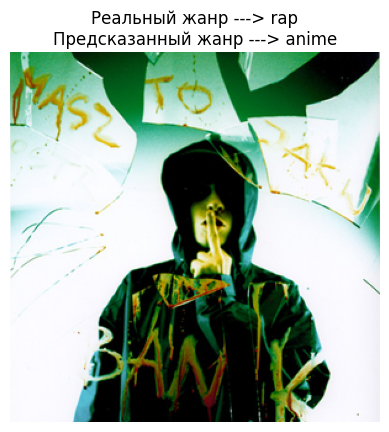

Модель ошиблась!
Рекомендуем также послушать.


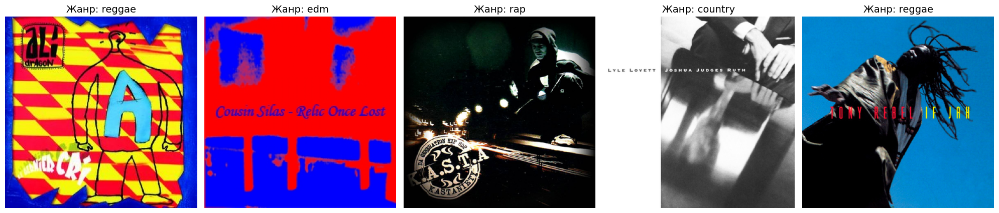

Время выполнения: 8.88 секунд(ы)


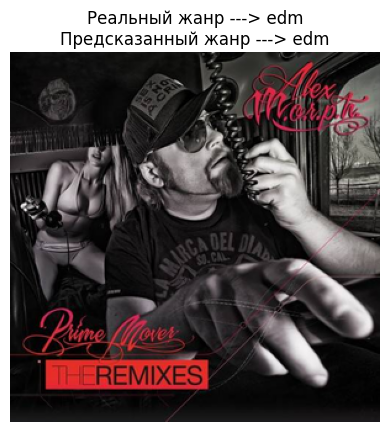

Жанр предсказан верно!
Рекомендуем также послушать.


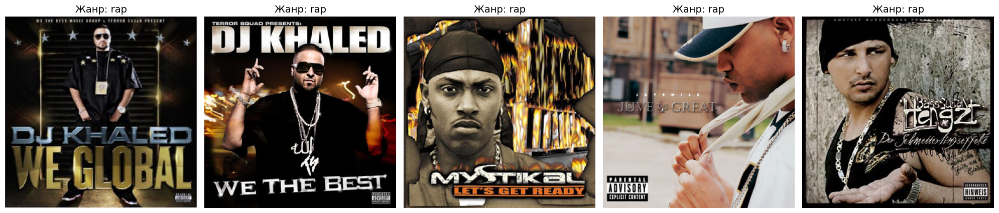

Время выполнения: 7.67 секунд(ы)


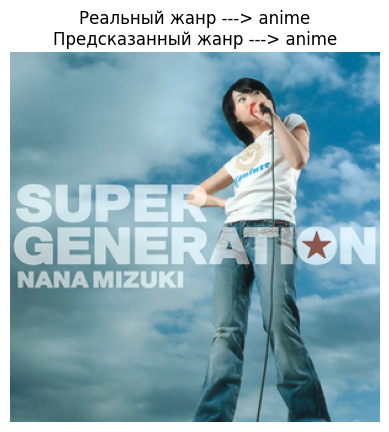

Жанр предсказан верно!
Рекомендуем также послушать.


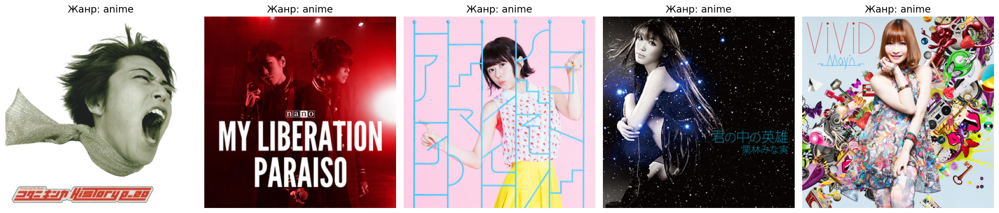

Время выполнения: 8.17 секунд(ы)


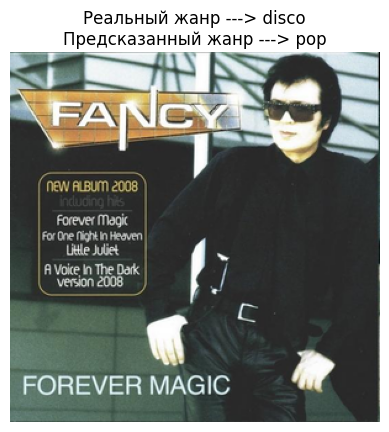

Модель ошиблась!
Рекомендуем также послушать.


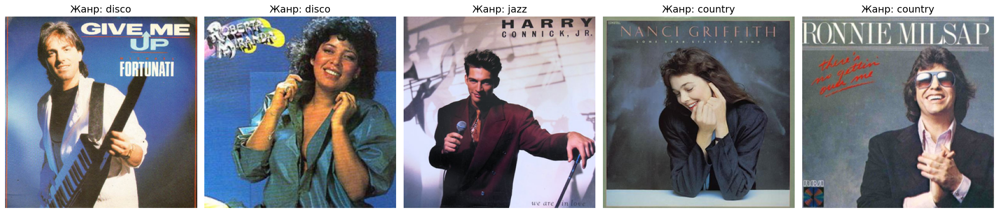

Время выполнения: 7.52 секунд(ы)


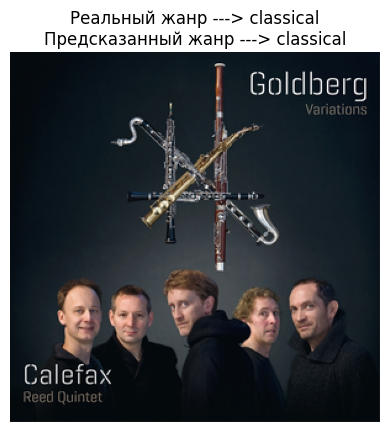

Жанр предсказан верно!
Рекомендуем также послушать.


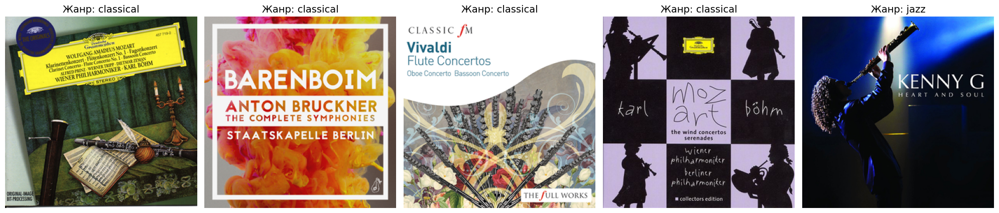

Время выполнения: 6.93 секунд(ы)


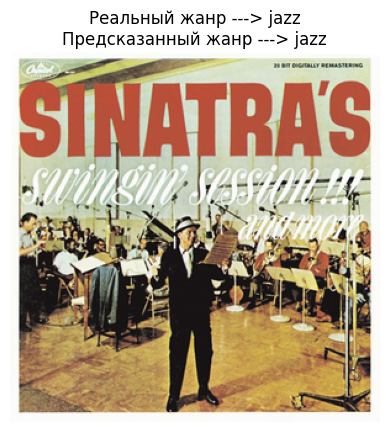

Жанр предсказан верно!
Рекомендуем также послушать.


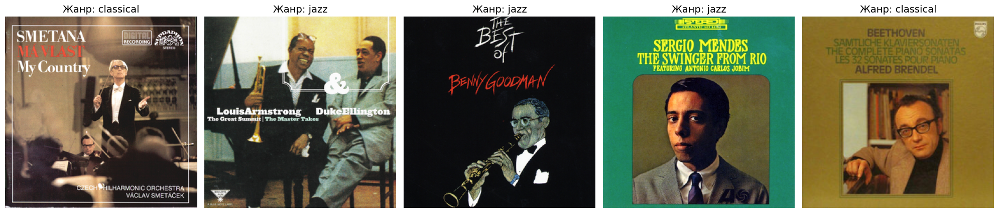

Время выполнения: 5.68 секунд(ы)


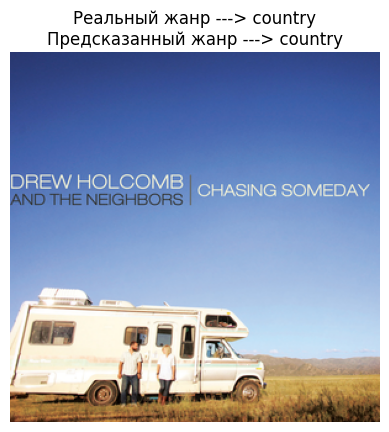

Жанр предсказан верно!
Рекомендуем также послушать.


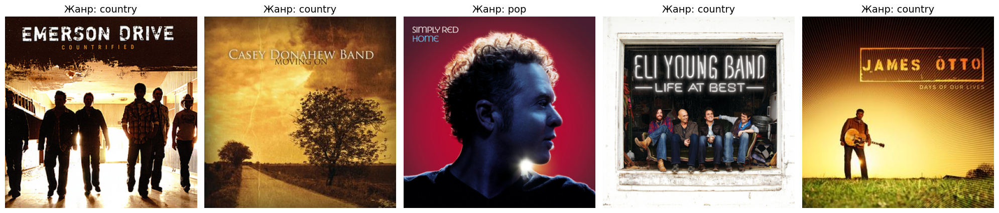

Время выполнения: 6.06 секунд(ы)


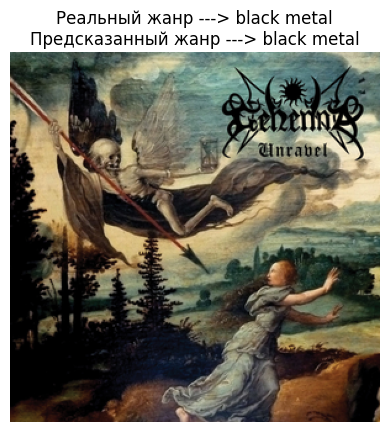

Жанр предсказан верно!
Рекомендуем также послушать.


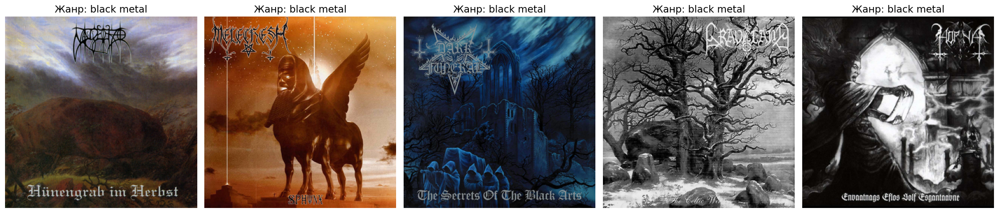

Время выполнения: 5.67 секунд(ы)


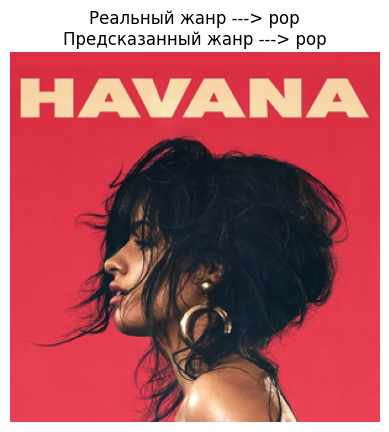

Жанр предсказан верно!
Рекомендуем также послушать.


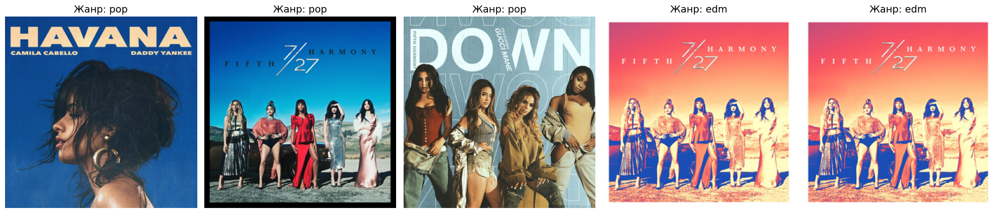

Время выполнения: 5.44 секунд(ы)


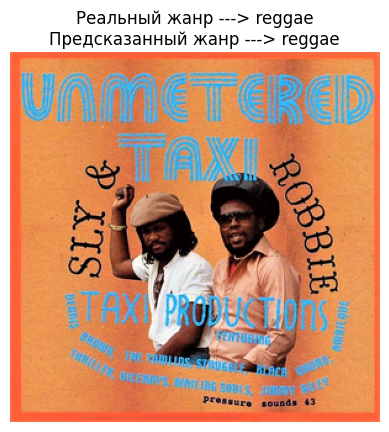

Жанр предсказан верно!
Рекомендуем также послушать.


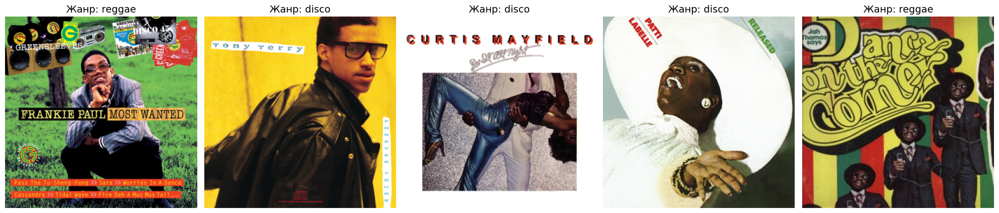

Время выполнения: 5.74 секунд(ы)


In [35]:
for key, value in choice_ramdom_image(source_dir=TEST_DIR).items():
    predict_one_image(
        url_for_image=value,
        real_genre=key,
        model=model,
        transform=image_transforms_v2,
        idx_to_class_dict=idx_to_class,
        image_vect_model=img_vect,
        source_emb=data,
        top_k=5,
        device="cpu",
    )

По жанрам где-то модель ошиблась, но в большинстве предсказания правильные, а вот по ближайшим соседям, тут получается следующая картина...

Т.к. набор изображений очень сложный, и классифицировать нужно не объекты на изображении, а жанр, то при нахождении схожих векторов видно, что например характерные картинки для металла, аниме, классики модель улавливает хорошо. С репом так же хороший результат, т.к. характерные типажи присуствуют. А вот если структура изображений у разных жанров сходная, то тут модель ошибается. Плюс ко всему есть группа с многими жанрами - `edm` и `pop`. В жанре `edm` вообще картинка характерная для репа, вот модель и выдала в похожих один реп.

**Ещё 10 случайных изображений и 5 ближайших соседей**

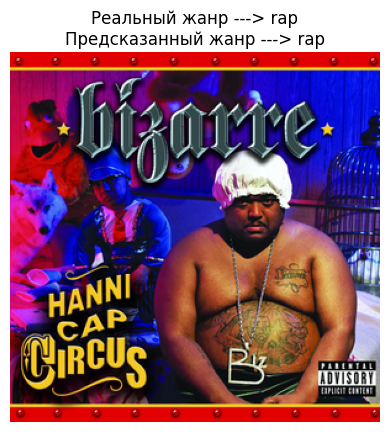

Жанр предсказан верно!
Рекомендуем также послушать.


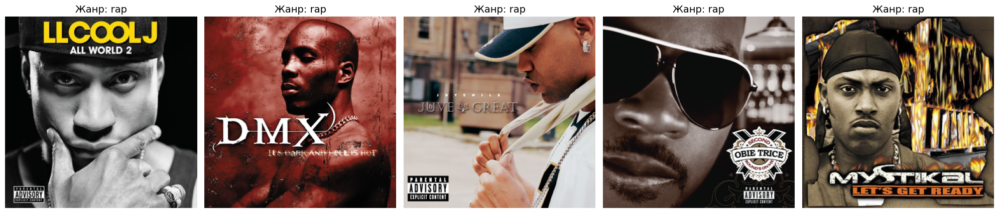

Время выполнения: 5.54 секунд(ы)


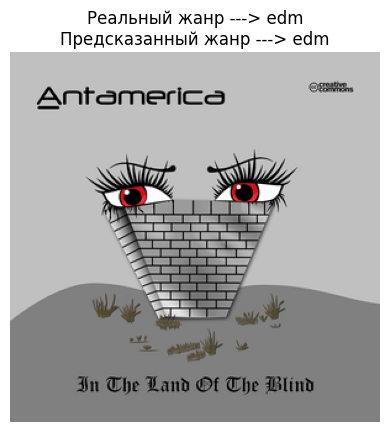

Жанр предсказан верно!
Рекомендуем также послушать.


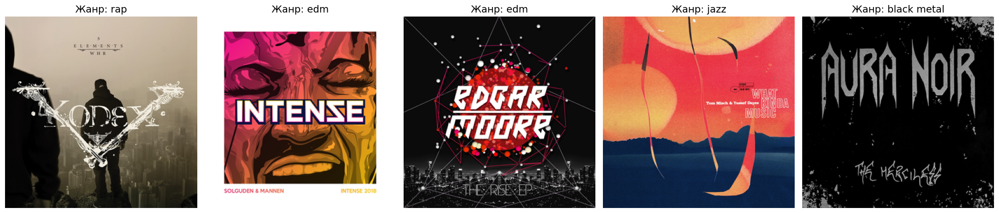

Время выполнения: 6.08 секунд(ы)


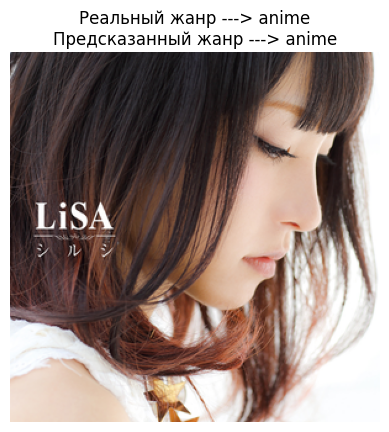

Жанр предсказан верно!
Рекомендуем также послушать.


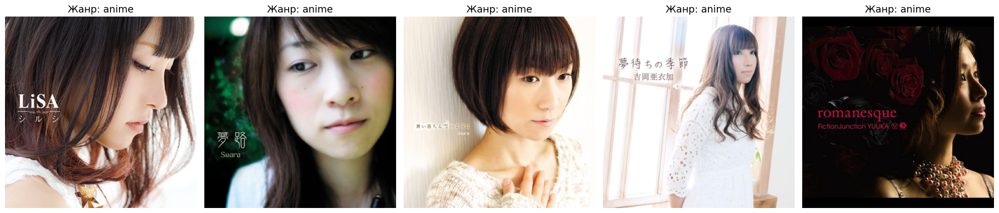

Время выполнения: 7.4 секунд(ы)


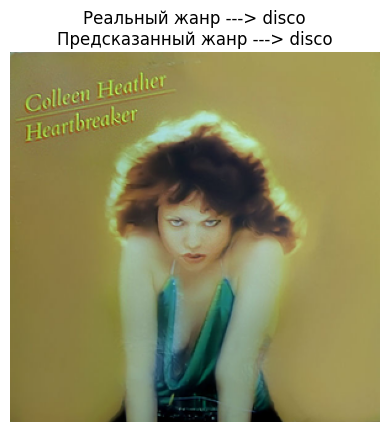

Жанр предсказан верно!
Рекомендуем также послушать.


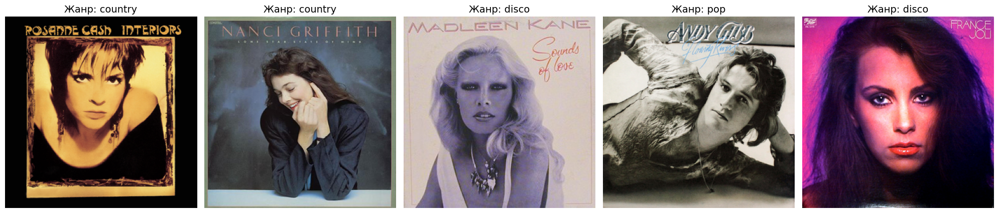

Время выполнения: 6.48 секунд(ы)


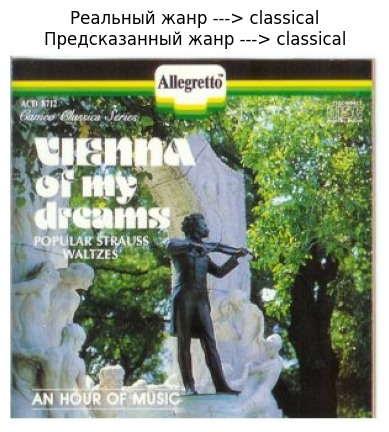

Жанр предсказан верно!
Рекомендуем также послушать.


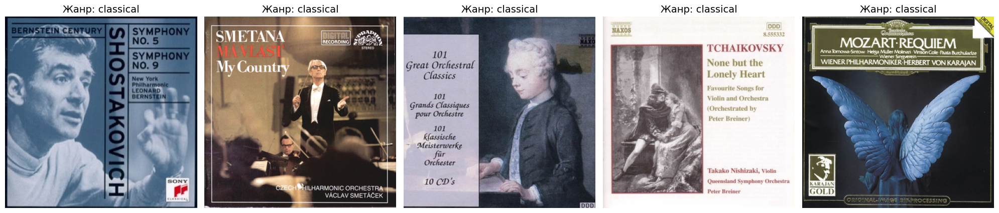

Время выполнения: 6.33 секунд(ы)


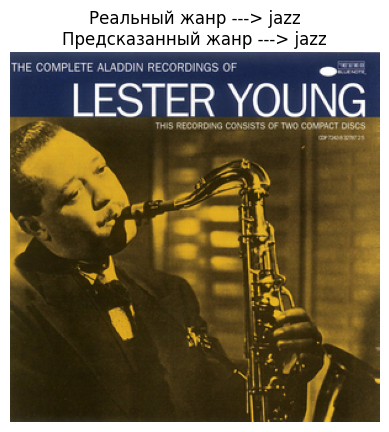

Жанр предсказан верно!
Рекомендуем также послушать.


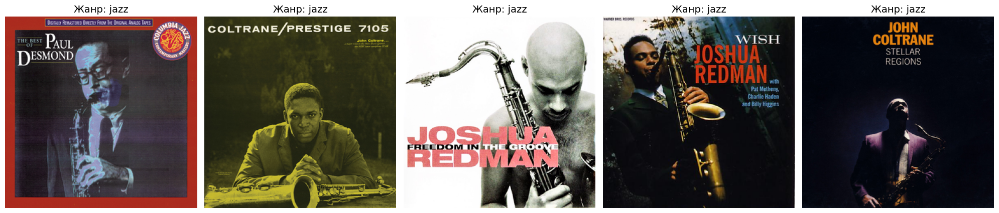

Время выполнения: 6.02 секунд(ы)


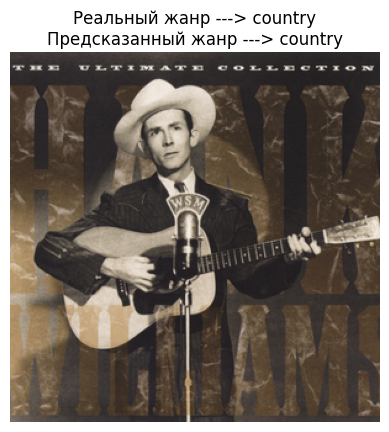

Жанр предсказан верно!
Рекомендуем также послушать.


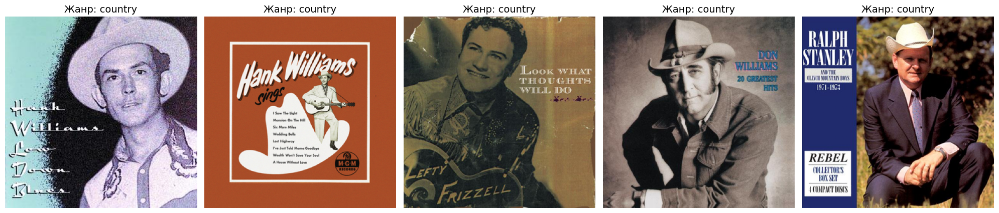

Время выполнения: 5.54 секунд(ы)


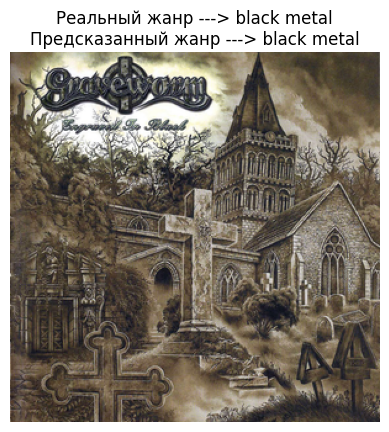

Жанр предсказан верно!
Рекомендуем также послушать.


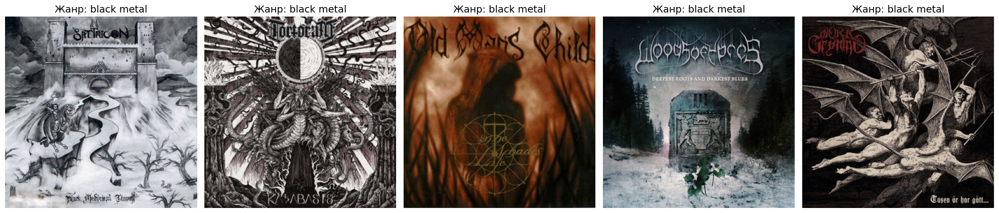

Время выполнения: 4.32 секунд(ы)


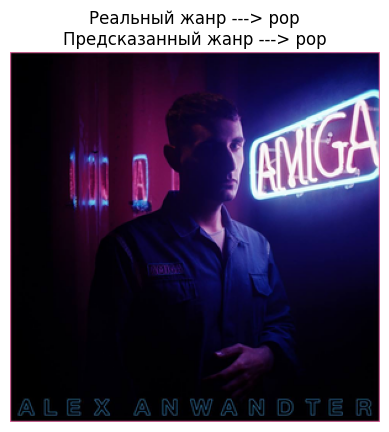

Жанр предсказан верно!
Рекомендуем также послушать.


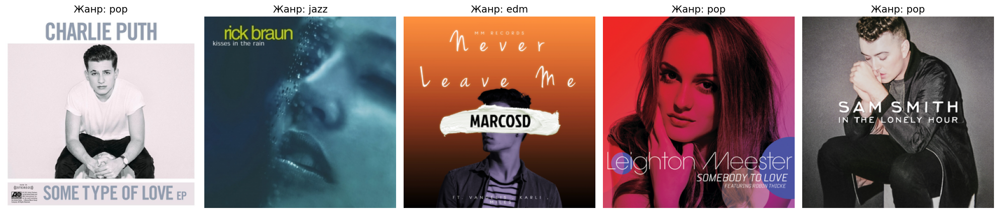

Время выполнения: 4.42 секунд(ы)


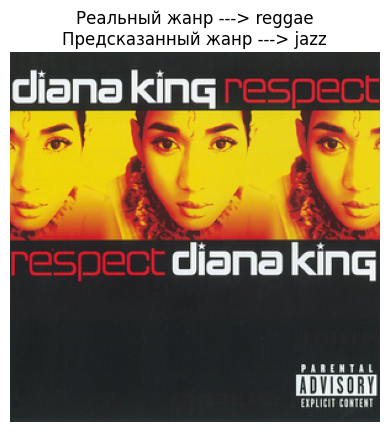

Модель ошиблась!
Рекомендуем также послушать.


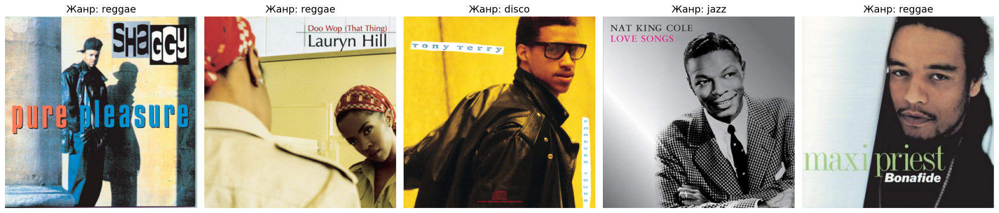

Время выполнения: 4.45 секунд(ы)


In [36]:
for key, value in choice_ramdom_image(source_dir=TEST_DIR).items():
    predict_one_image(
        url_for_image=value,
        real_genre=key,
        model=model,
        transform=image_transforms_v2,
        idx_to_class_dict=idx_to_class,
        image_vect_model=img_vect,
        source_emb=data,
        top_k=5,
        device="cpu",
    )

Тут аналогично. Плюс кантри хоршо проклассифицирован.

## Вывод

В результате исследования была дообучена (Transfer Learning) модель `VIT` - `Vision Transformer`. Получена метрика `accuracy` на тестовой выборке `83%` и реализована мини-рекомендательная система на основе дообученной модели. 

Модель хорошо сравляется с предсказаниями жанров с характерными для определенного жанра изображениями, а там где изображения по фактуре сходны, но жанры разные модель может ошибаться, равно как ее вводят в заблуждение многожанровые группы.  